In [1]:
import torch
import ChemSurrogate.data_processing as dp
from ChemSurrogate.configs import DatasetConfig, AEConfig, EMConfig, PredefinedTensors
import ChemSurrogate.analysis as analysis
from ChemSurrogate.trainer import load_emulator_objects, load_autoencoder_objects
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import rc
import pandas as pd
import os

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


#species_of_interest = ["H", "H2", "O", "C", "N", "SPlus", "MG", "SIPlus", "CL", "CPlus", "SURFACE", "BULK", "AtCO", "AtH", "E_minus"]
species_of_interest = ["H", "H2", "O", "C", "N", "CL", "E_minus", "CO"]

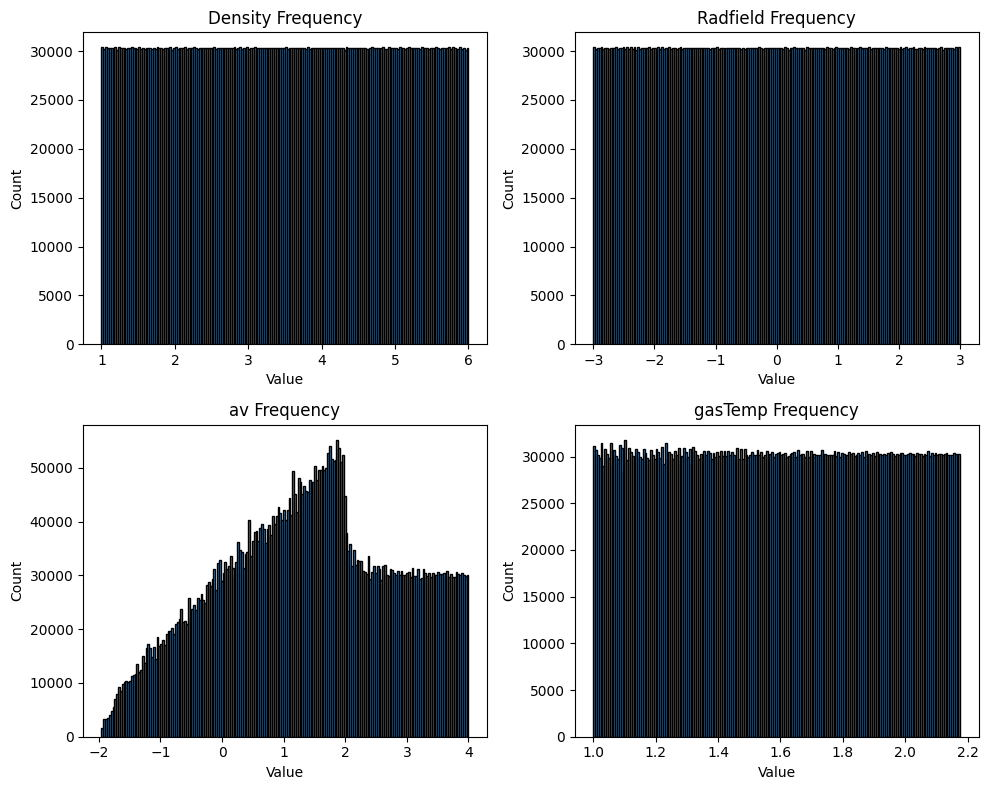

In [4]:
validation_t, _ = dp.load_tensors_from_hdf5(category="training") # This has columns [metadata, physical_parameters, species, encoded_species]

left_index = DatasetConfig.num_metadata
right_index = DatasetConfig.num_metadata + DatasetConfig.num_physical_parameters
scaled_physical_parameters = validation_t[:, left_index:right_index].numpy()
physical_parameters = dp.inverse_physical_parameter_scaling(scaled_physical_parameters)

output_path = "plots/physical_parameters_histogram.png"
analysis.histogram_physical_parameters(
    sampled_physical_parameters=physical_parameters,
    savefig_path=output_path,
)

### This section is for obtaining the error plots across species and timesteps.

In [5]:
emulator, autoencoder, _, _ = load_emulator_objects(is_inference=True)

validation_t, validation_indices = dp.load_tensors_from_hdf5(category="validation") # This has columns [metadata, physical_parameters, species, encoded_species]

validation_Dataset = dp.RowRetrievalDataset(validation_t, validation_indices)

validation_dataloader = dp.tensor_to_dataloader(EMConfig, validation_Dataset, is_emulator=True)

num_timesteps = 100
num_species = DatasetConfig.num_species

total_count = torch.zeros(num_timesteps, dtype=torch.float32).to(device)

total_rel_error = torch.zeros(num_timesteps, num_species, dtype=torch.float32).to(device)
total_mace_error = torch.zeros(num_timesteps, dtype=torch.float32).to(device)
total_conservation_error = torch.zeros(num_timesteps, dtype=torch.float32).to(device)
with torch.no_grad():
    for features, targets in validation_dataloader:
        features = features.to(device)
        targets = targets.to(device)
        emulated_features = dp.emulator_inferencing(emulator, features, scale_components=False)
        decoded_features = dp.decoder_inferencing(autoencoder, emulated_features)
        
        unscaled_targets = dp.inverse_abundances_scaling(targets)
        
        conservation_error = analysis.calculate_conservation_error(unscaled_targets, decoded_features)
        relative_error = analysis.calculate_relative_error(decoded_features, unscaled_targets)
        mace_error = analysis.calculate_mace_error(decoded_features, unscaled_targets)
        
        timesteps = (features[:, 0] * num_timesteps).round().long() - 1
        timesteps_species = timesteps.unsqueeze(1).expand(-1, num_species)
        
        sample_count = torch.ones(features.size(0), dtype=torch.float32, device=device)
        total_count.scatter_add_(0, timesteps, sample_count)
                
        total_rel_error.scatter_add_(0, timesteps_species, relative_error)
        total_mace_error.scatter_add_(0, timesteps, mace_error)
        total_conservation_error.scatter_add_(0, timesteps, conservation_error)

mean_rel_error_timestep_species = torch.zeros_like(total_rel_error.cpu())
mean_rel_error_timestep_species = (
    total_rel_error.cpu() / total_count.cpu().unsqueeze(1)
)

mean_rel_error_across_species = mean_rel_error_timestep_species.mean(dim=1)
std_rel_error_timestep = mean_rel_error_timestep_species.std(dim=1)
mean_mace_error_timestep = total_mace_error.cpu() / total_count.cpu()
mean_conservation_error_timestep = total_conservation_error.cpu() / total_count.cpu()

Loading Pretrained Model
Data_matrix Memory usage: 2712.402 MB
Index_pairs Memory usage: 1155.85 MB

Dataset Size: 2020000 | Index Pairs: 101000000



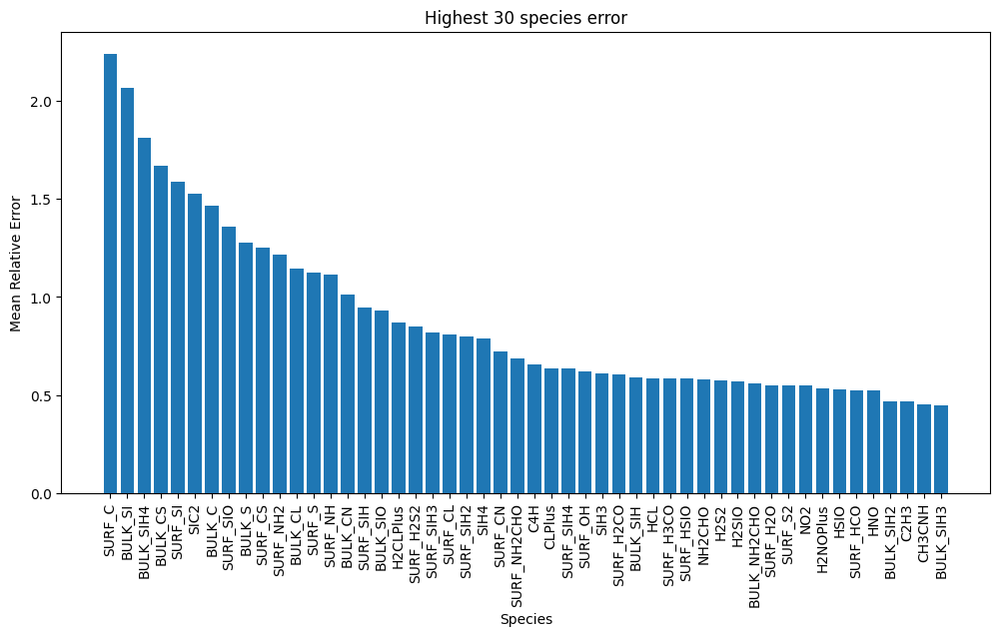

In [6]:
import pandas as pd
import matplotlib.pyplot as plt

# Convert the tensor to a NumPy array and flatten it
errors = mean_rel_error_timestep_species[:50].mean(axis=0).numpy().flatten()

# Create the DataFrame
species_errors = pd.DataFrame({'Species': DatasetConfig.species, 'Error': errors})

# Sort by Error in descending order and select the top 30 worst performing species
species_errors = species_errors.sort_values(by='Error', ascending=False).head(50)

# Plot
plt.figure(figsize=(12, 6))
plt.bar(species_errors['Species'], species_errors['Error'])
plt.xlabel('Species')
plt.ylabel('Mean Relative Error')
plt.xticks(rotation=90)  # Rotate species names for better readability
plt.title('Highest 30 species error')
plt.show()


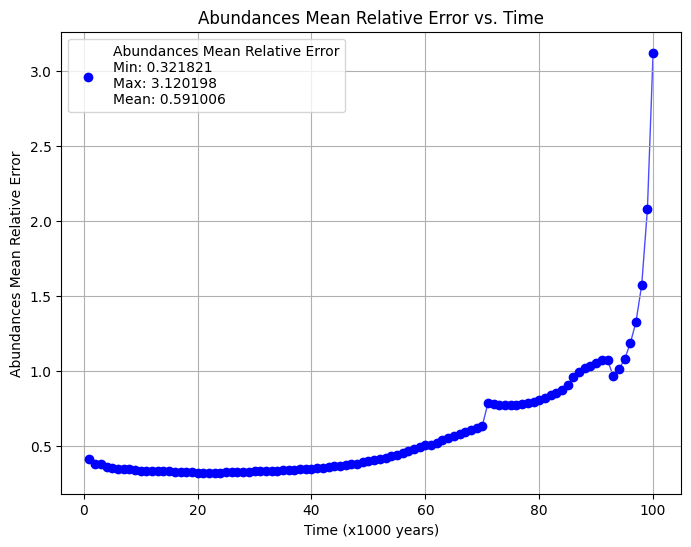

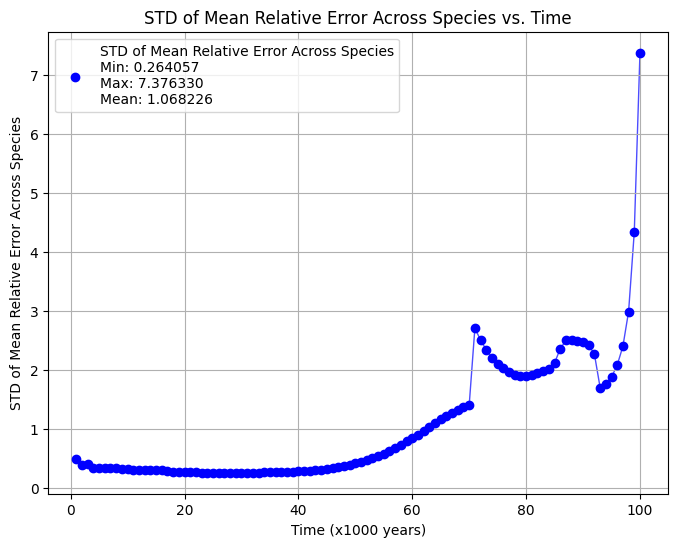

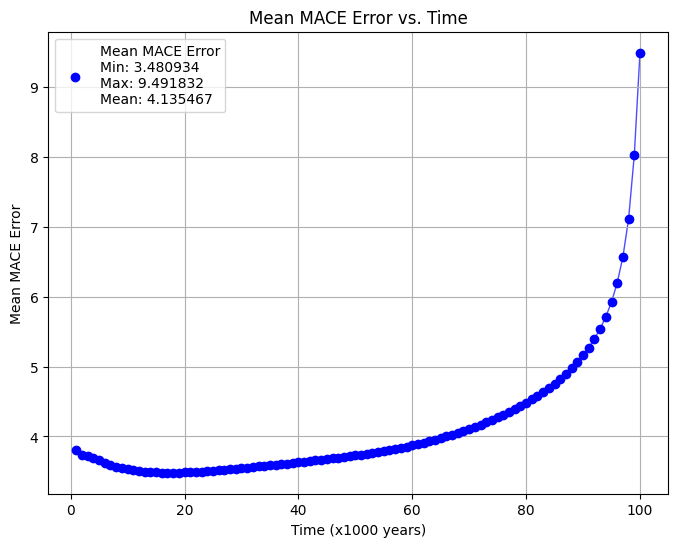

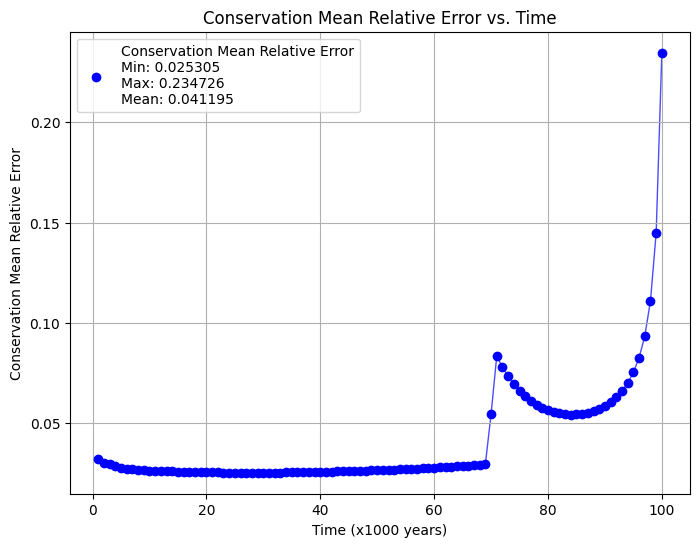

In [10]:
analysis.plot_error_vs_time(
    mean_rel_error_across_species,
    label = "Abundances Mean Relative Error",
    save_path = "../plots/errors/mean_relative_errors.png"
    )
analysis.plot_error_vs_time(
    std_rel_error_timestep,
    label = "STD of Mean Relative Error Across Species",
    save_path = "../plots/errors/std_relative_errors.png"
    )
analysis.plot_error_vs_time(
    mean_mace_error_timestep,
    label = "Mean MACE Error",
    save_path = "../plots/errors/mace_errors.png"
    )
analysis.plot_error_vs_time(
    mean_conservation_error_timestep,
    label = "Conservation Mean Relative Error",
    save_path = "../plots/errors/conservation_errors.png"
    )


In [11]:
timestep = 95

training_t, _ = dp.load_tensors_from_hdf5(category="training") # This has columns [metadata, physical_parameters, species, encoded_species]
filtered_t = training_t[training_t[:, 2] == timestep*1000][:, DatasetConfig.num_metadata:-AEConfig.latent_dim]
del training_t
filtered_t[:, :DatasetConfig.num_physical_parameters] = dp.inverse_physical_parameter_scaling(filtered_t[:, :DatasetConfig.num_physical_parameters])
filtered_t[:, DatasetConfig.num_physical_parameters:] = dp.inverse_abundances_scaling_cpu(filtered_t[:, DatasetConfig.num_physical_parameters:])

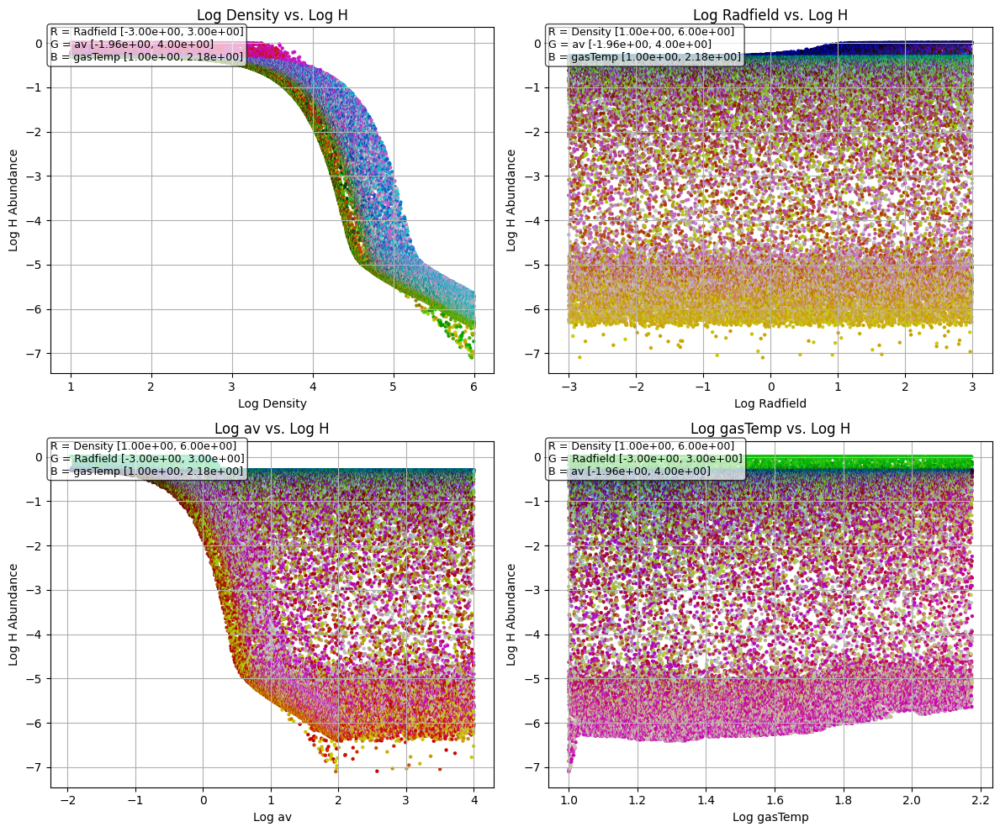

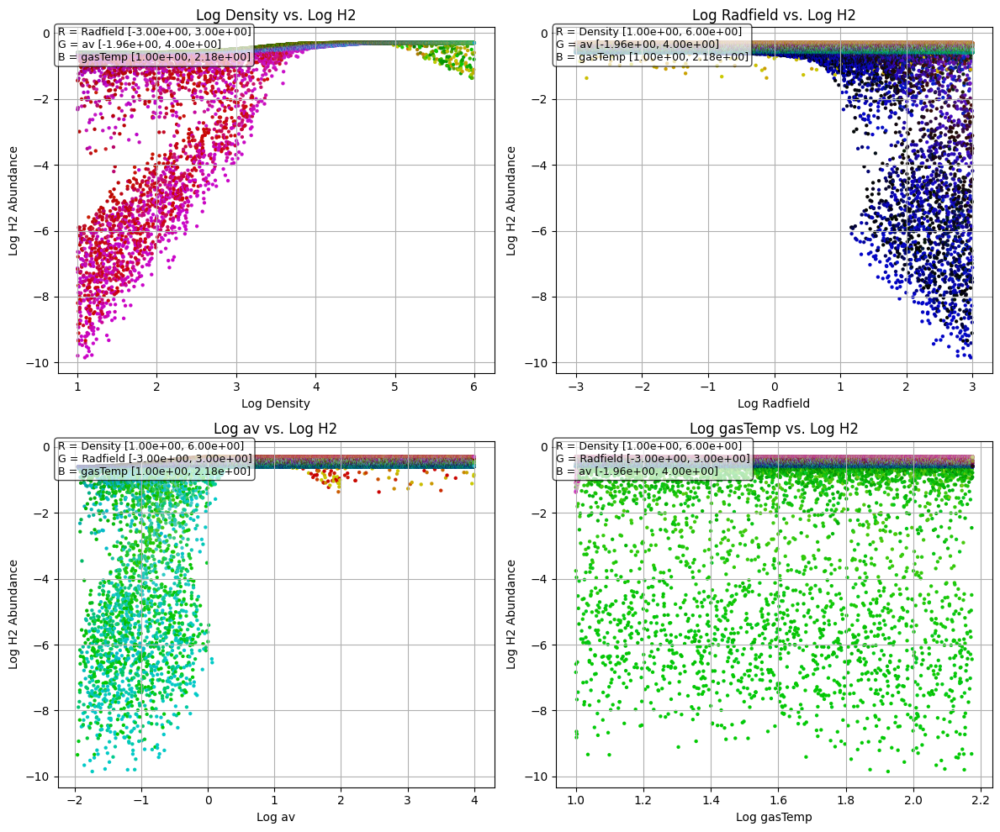

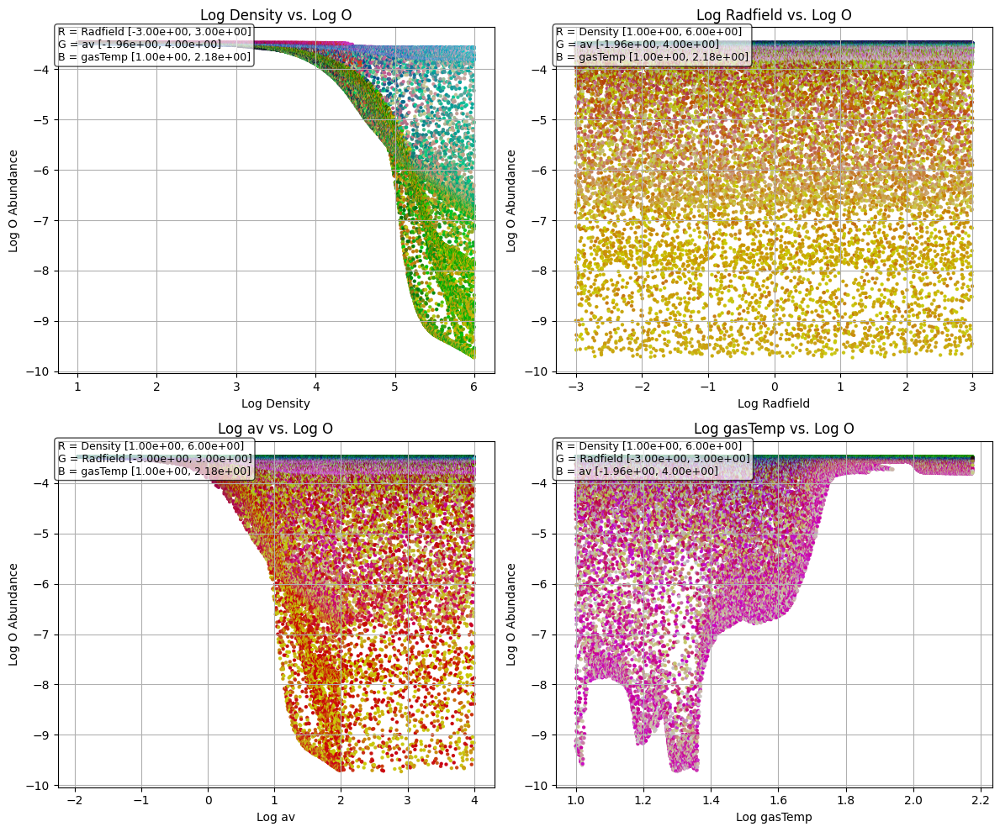

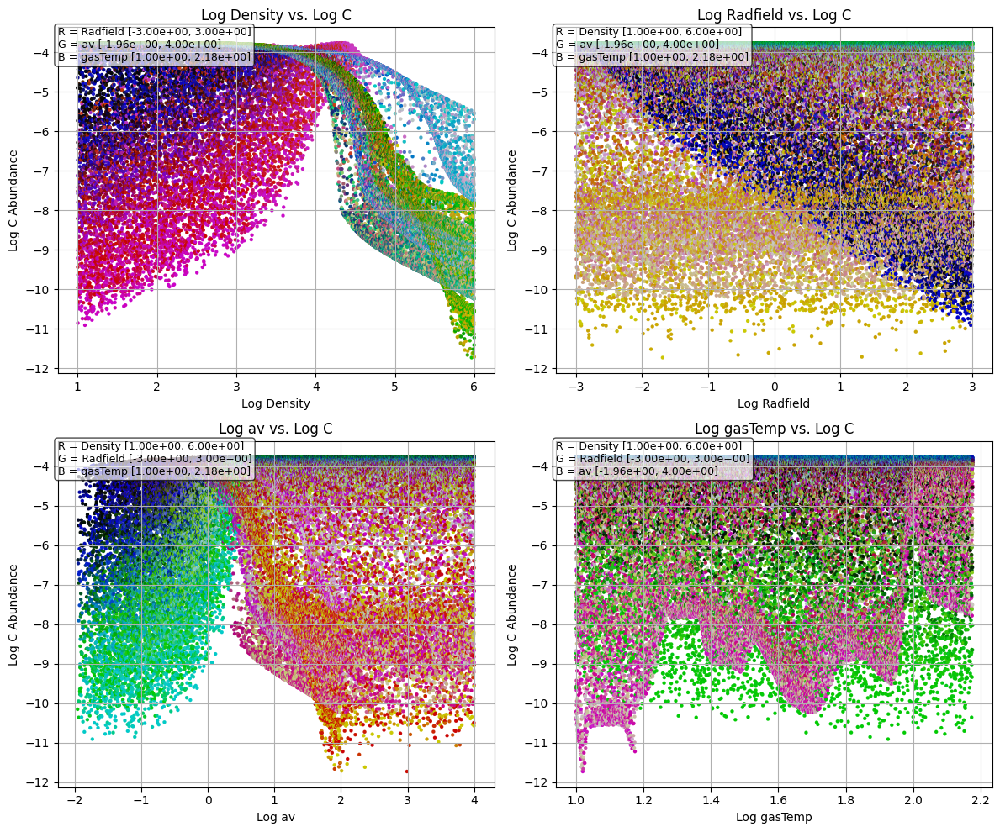

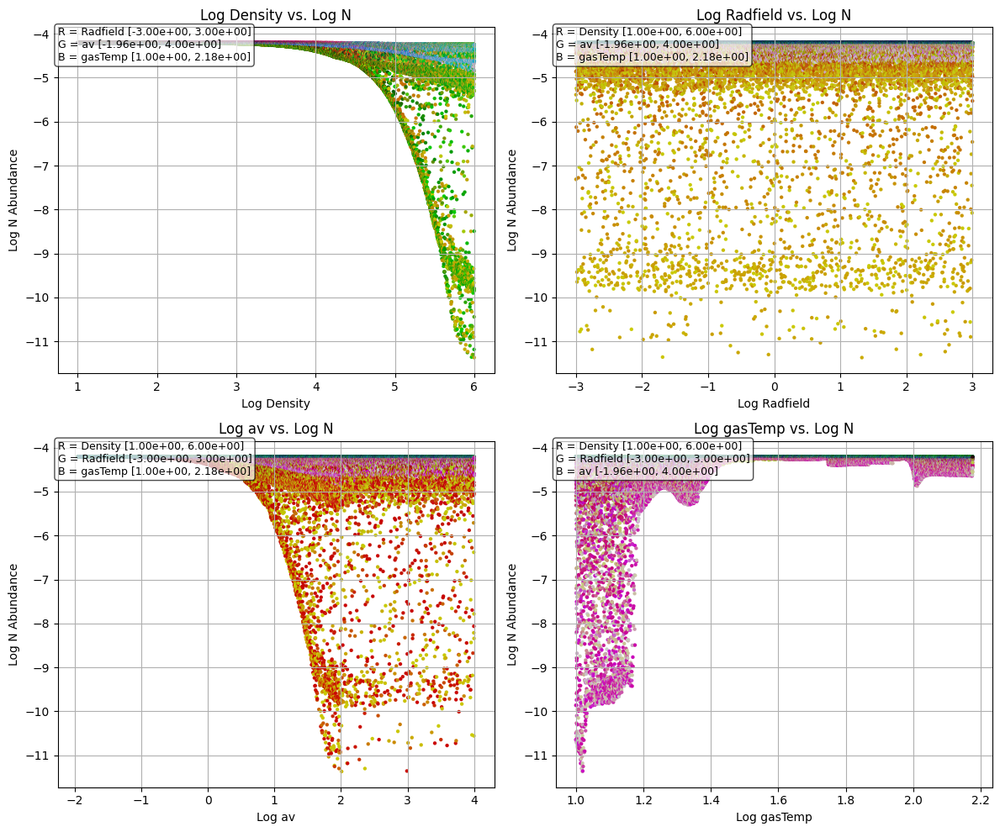

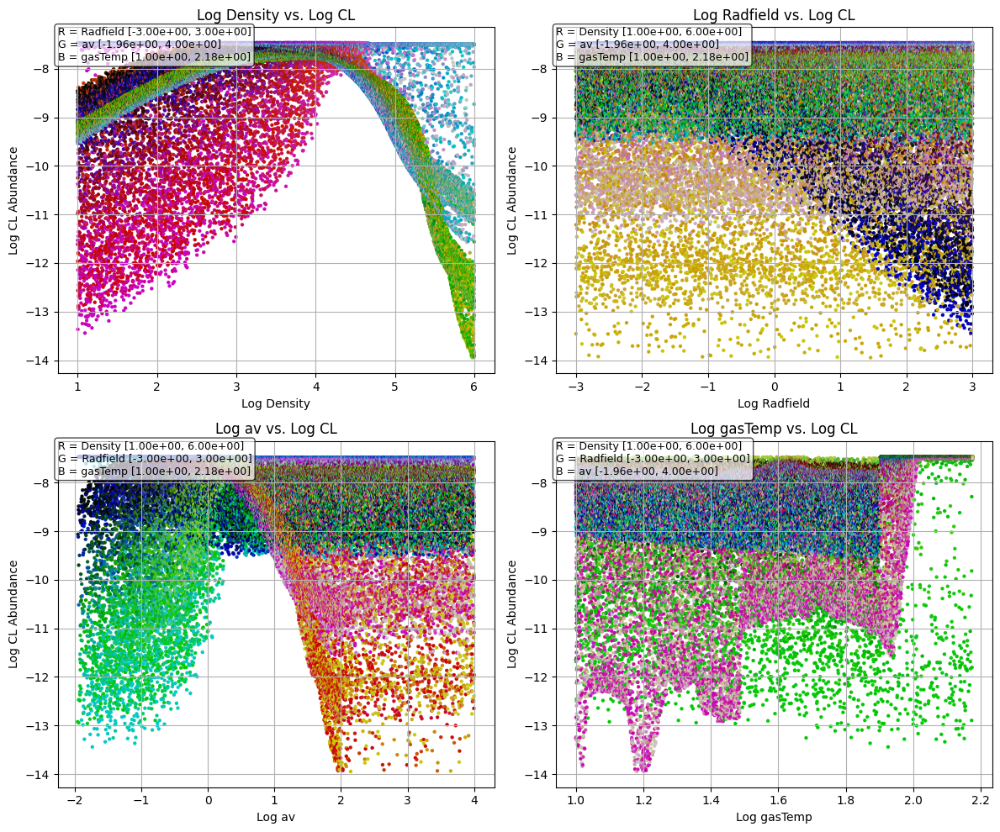

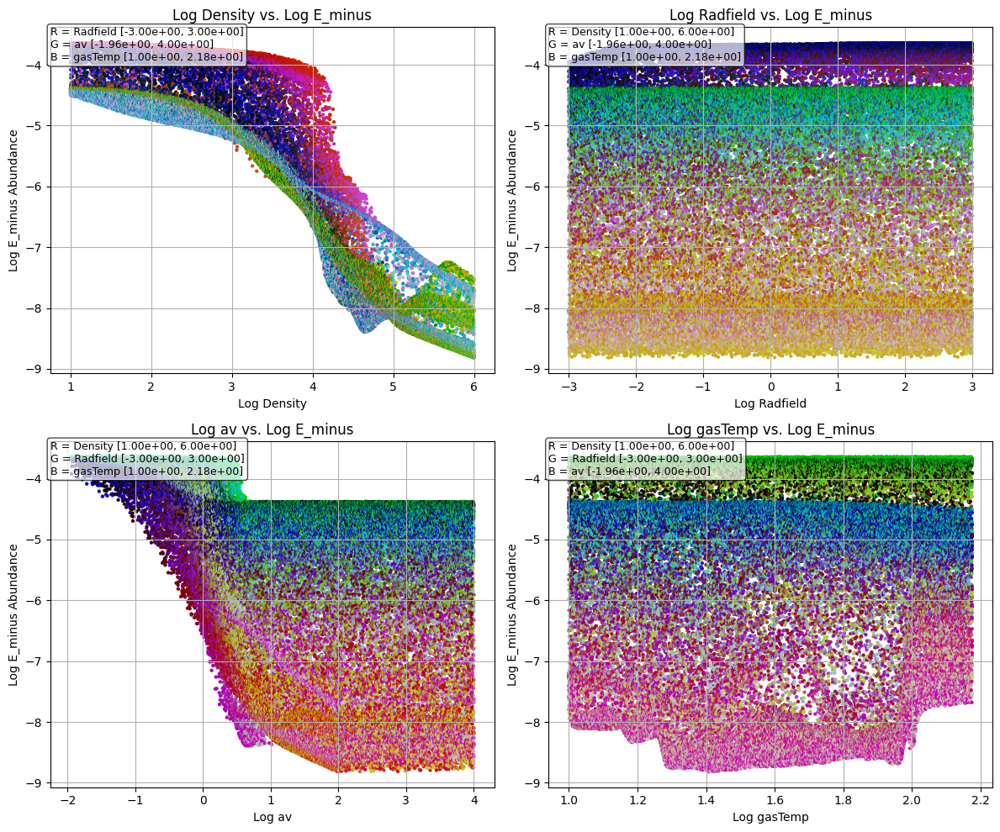

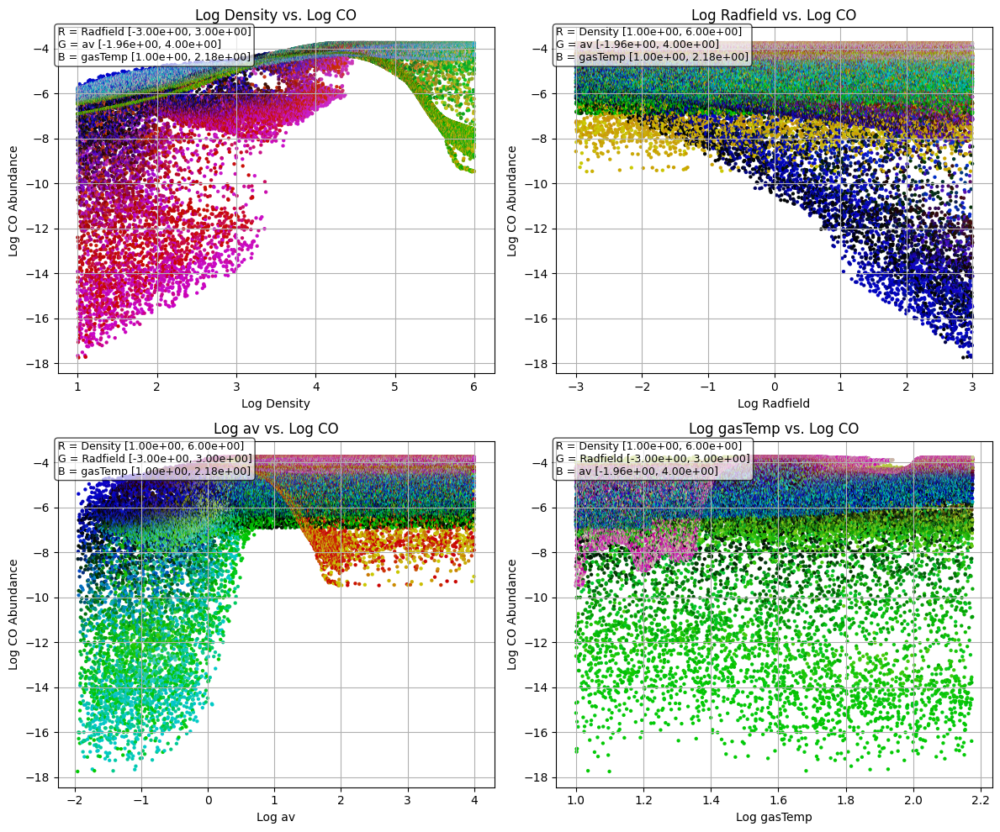

In [12]:
training_df = pd.DataFrame(filtered_t.numpy(), columns=DatasetConfig.physical_parameters + DatasetConfig.species)

output_folder = "plots/actual_abundances_vs_physical_parameters"
analysis.scatter_abundances_vs_physical_parameters(
    df = training_df,
    species_of_interest = species_of_interest,
    output_folder = output_folder
    )

In [2]:
num_samples = 100000
timestep = 95
initial_conditions = analysis.sample_initial_conditions(num_samples)
initial_conditions_with_time = analysis.add_timesteps_to_conditions(initial_conditions, timestep)

emulator, autoencoder, _, _ = load_emulator_objects(is_inference=True)

with torch.no_grad():
    encoded_features = dp.encoder_inferencing(autoencoder, initial_conditions_with_time)
    
    encoded_features = torch.cat((initial_conditions_with_time[:, :1+DatasetConfig.num_physical_parameters], encoded_features.cpu()), dim=1)
    
    encoded_features = dp.emulator_inferencing(emulator, encoded_features, convert_base_av=True)
    
    decoded_features = dp.decoder_inferencing(autoencoder, encoded_features)

results_df = analysis.reconstruct_results(initial_conditions_with_time, decoded_features)

Loading Pretrained Model


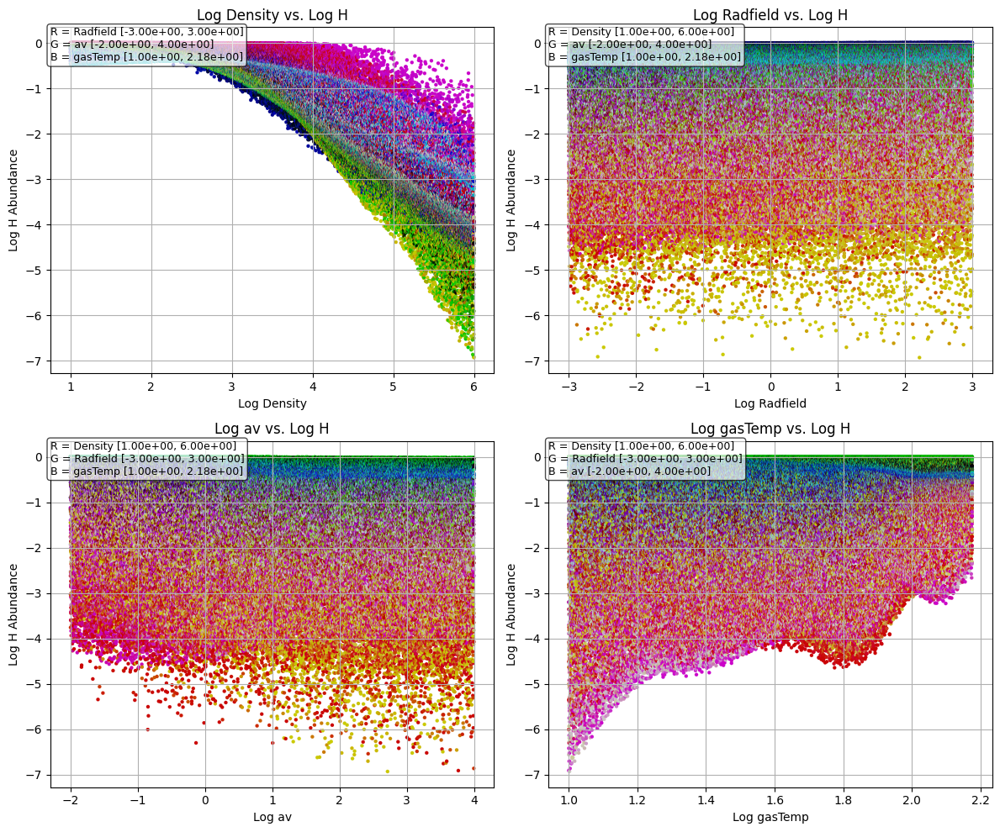

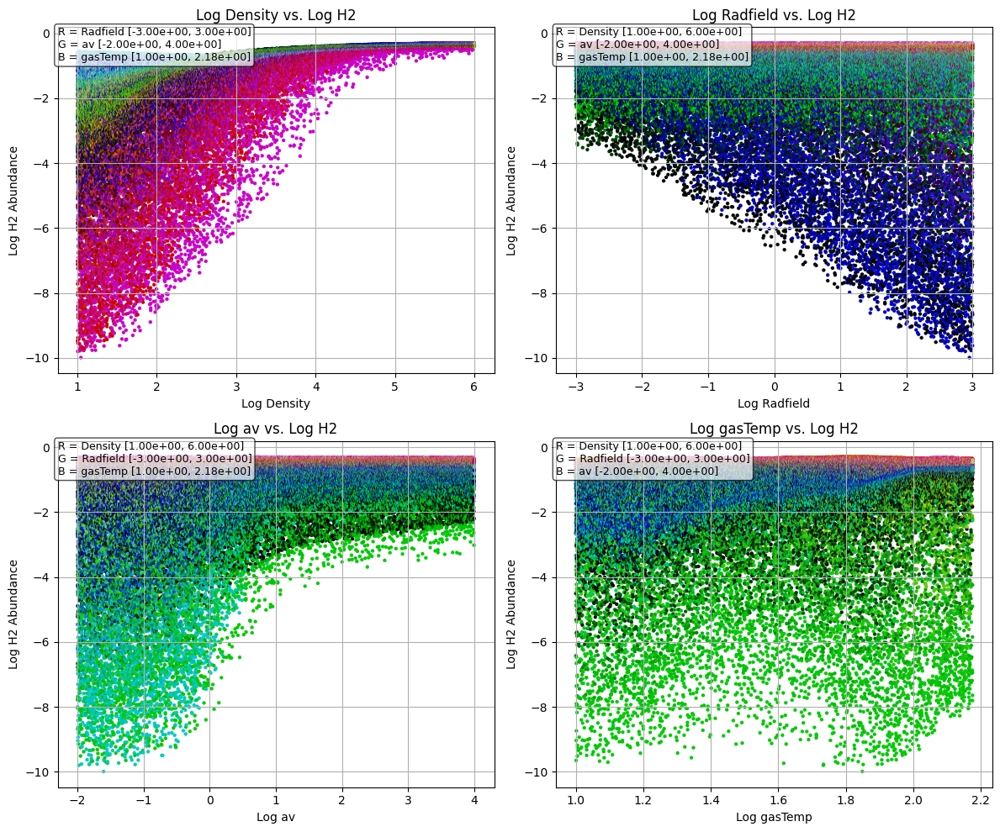

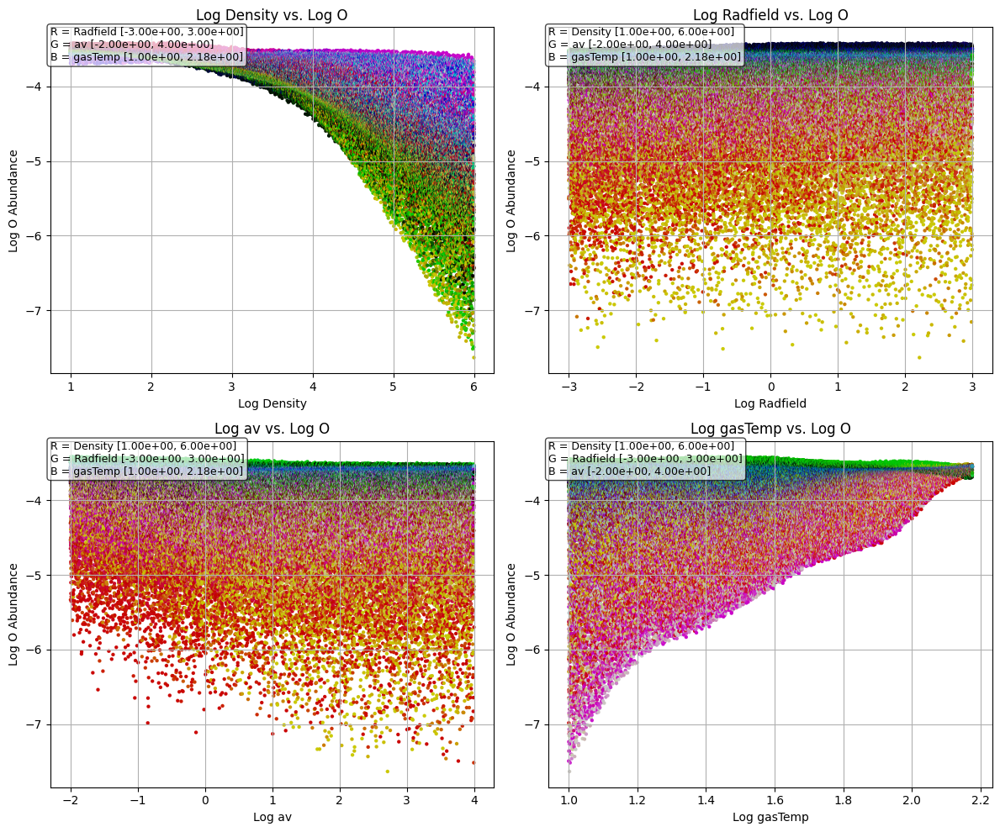

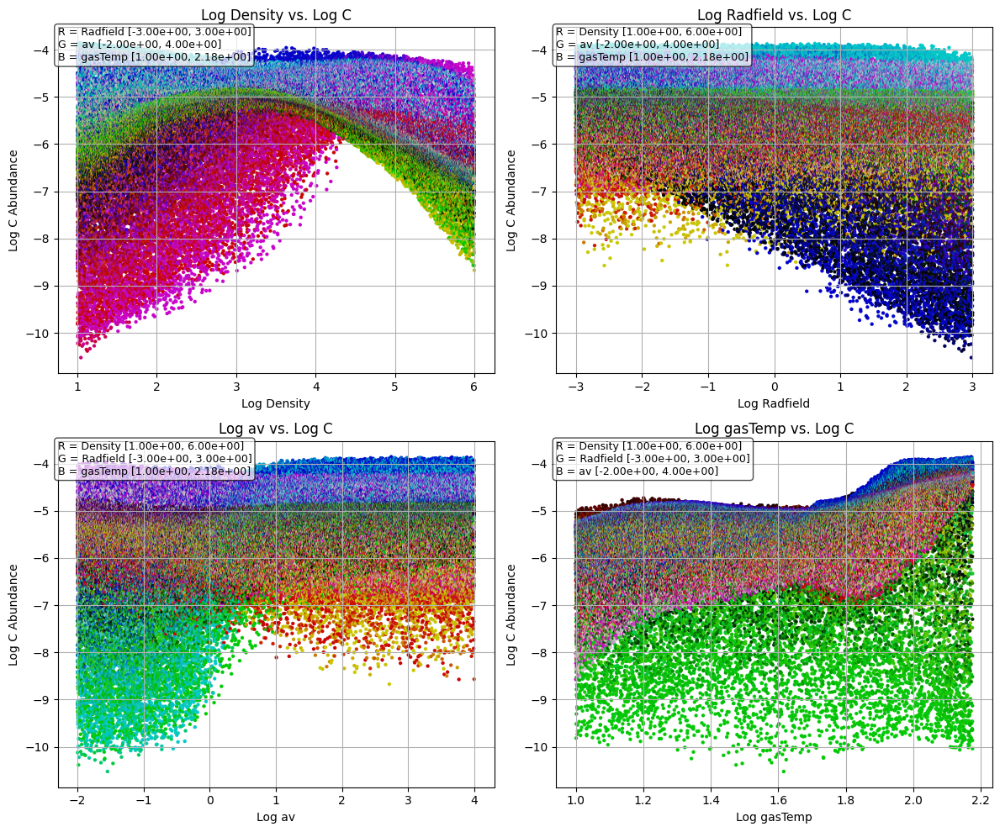

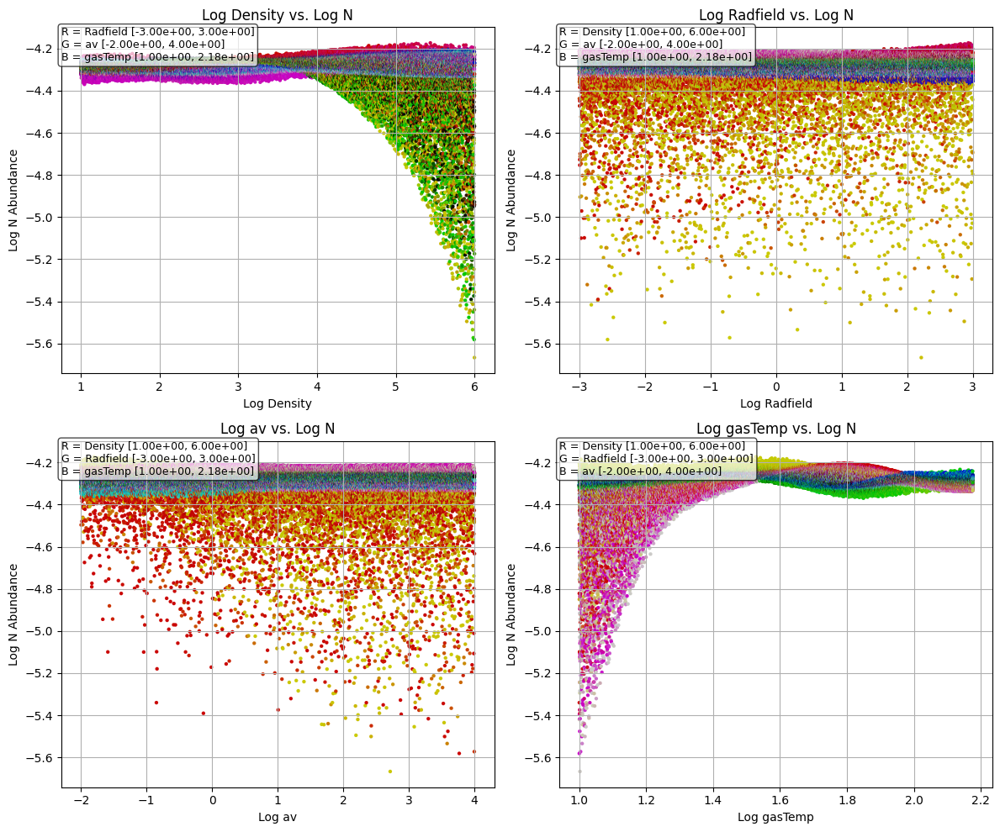

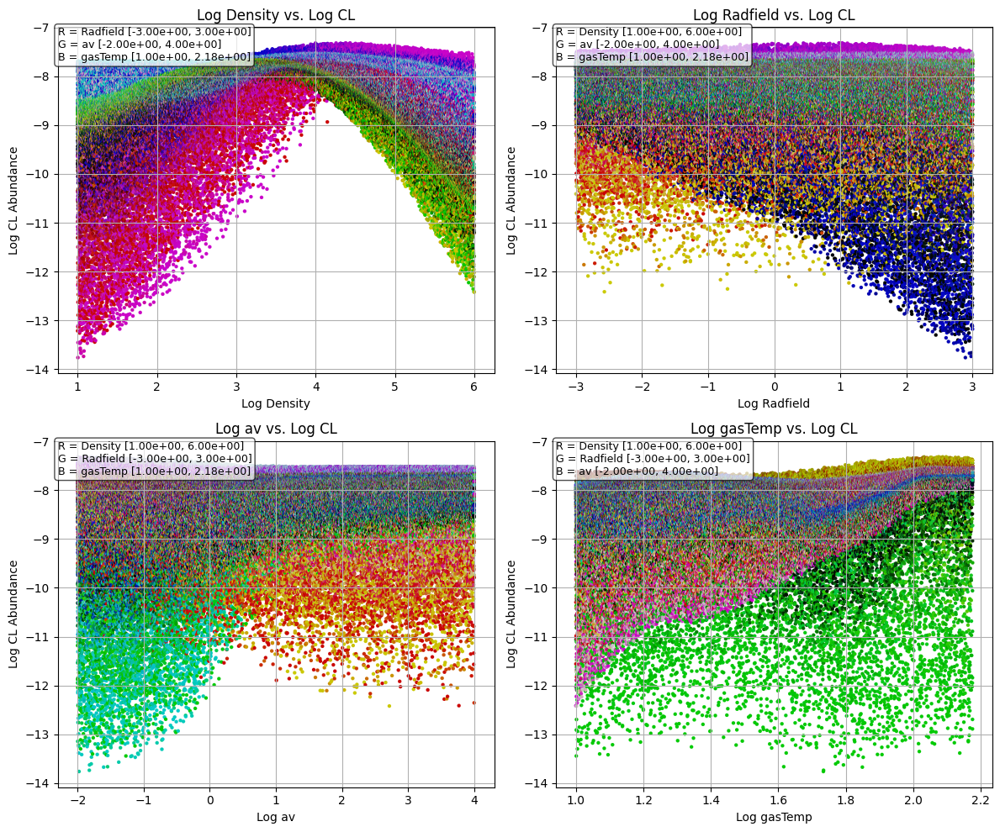

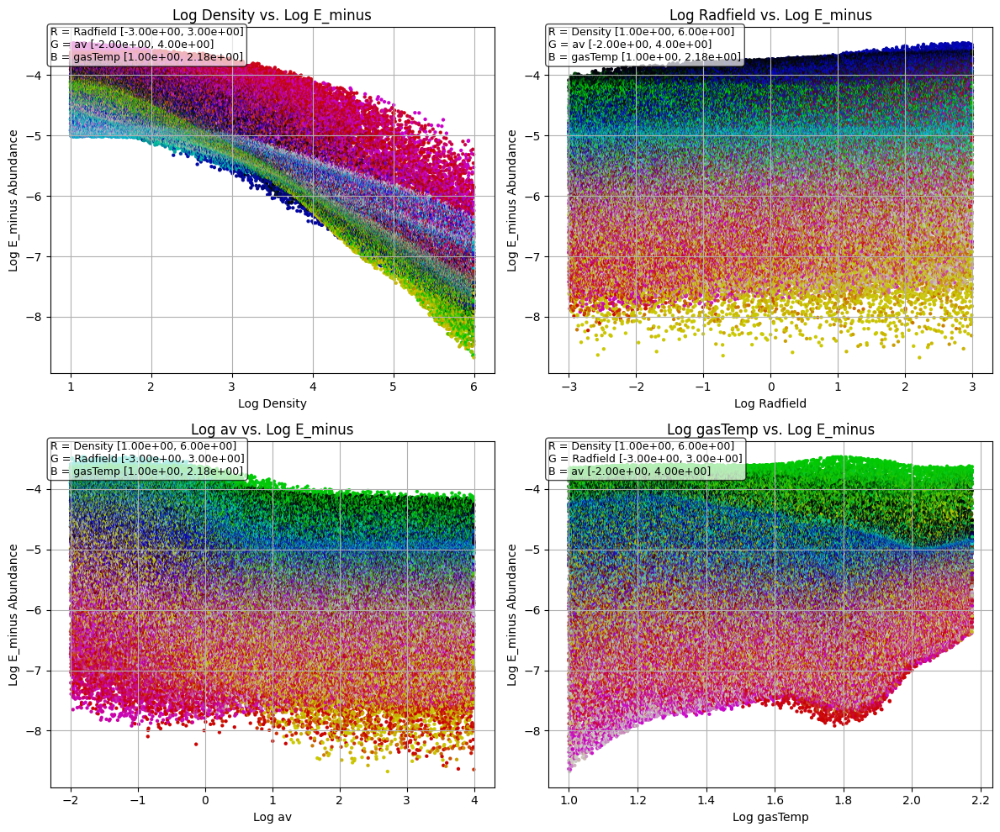

KeyboardInterrupt: 

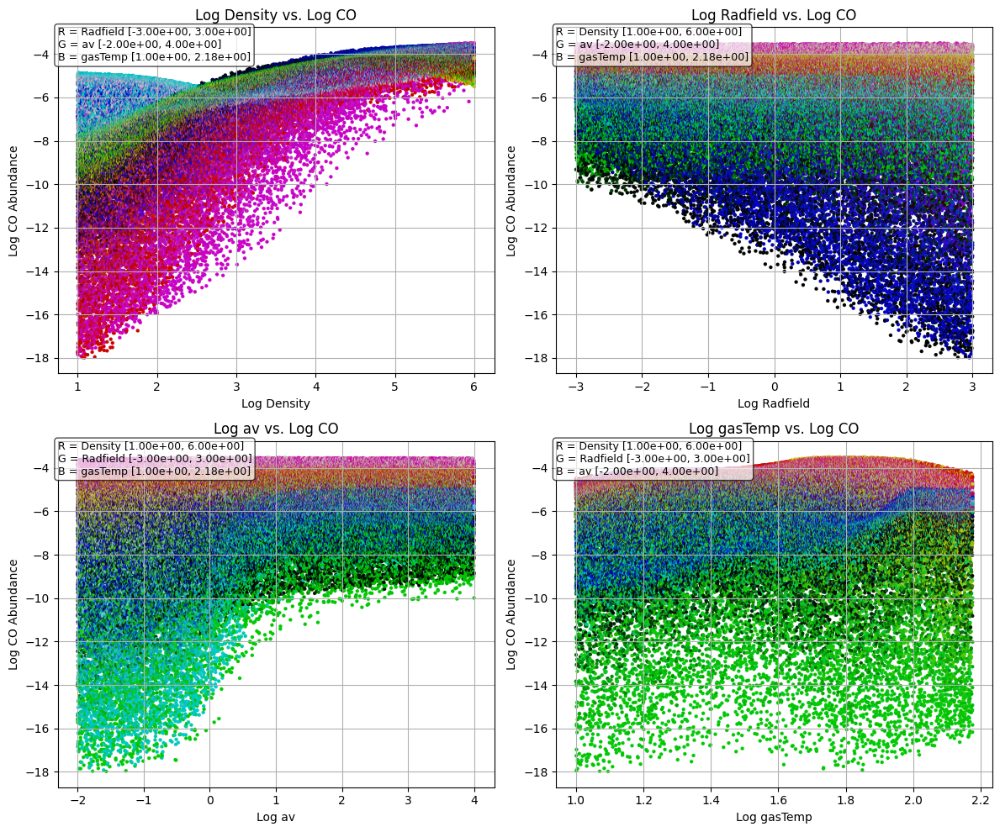

In [3]:
output_folder = "../plots/predicted_abundances_vs_physical_parameters"
analysis.scatter_abundances_vs_physical_parameters(
    df = results_df,
    species_of_interest = species_of_interest,
    output_folder = output_folder
    )

Loading Pretrained Model


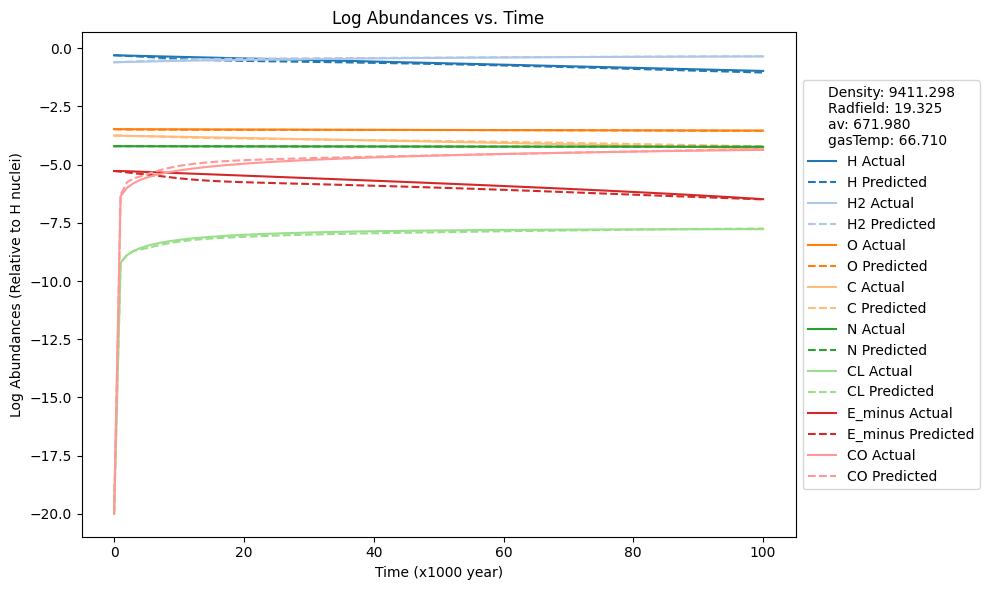

In [ ]:
model_idx_num = 17005
emulator, autoencoder, _, _ = load_emulator_objects(is_inference=True)

#species_of_interest = ["H", "H2", "O", "C", "N", "SPlus", "MG", "SIPlus", "CL", "CPlus", "SURFACE", "BULK", "CO", "AtH", "E_minus"]
species_of_interest = ["H", "H2", "O", "C", "N", "CL", "E_minus", "CO"]

validation_t, _ = dp.load_tensors_from_hdf5(category="validation") # This has columns [metadata, physical_parameters, species, encoded_species]

model_idx = validation_t[:, 1].unique()[model_idx_num]

model_t = validation_t[validation_t[:, 1] == model_idx][:, 2:-AEConfig.latent_dim]

model_t[:, 1+DatasetConfig.num_physical_parameters:] = dp.inverse_abundances_scaling_cpu(model_t[:, 1+DatasetConfig.num_physical_parameters:])

initial_conditions = model_t[0, 1:].unsqueeze(0)
initial_conditions_with_time = analysis.add_multiple_timesteps_to_conditions(initial_conditions, num_timesteps=model_t.size(0)-1)

with torch.no_grad():
    encoded_features = dp.encoder_inferencing(autoencoder, initial_conditions_with_time[:, 1+DatasetConfig.num_physical_parameters:])
    
    encoded_features = torch.cat((initial_conditions_with_time[:, :1+DatasetConfig.num_physical_parameters], encoded_features.cpu()), dim=1)
    
    encoded_features = dp.emulator_inferencing(emulator, encoded_features)
    
    decoded_features = dp.decoder_inferencing(autoencoder, encoded_features)

initial_abundances = model_t[0, 1+DatasetConfig.num_physical_parameters:].unsqueeze(0)

decoded_features = torch.vstack([initial_abundances, decoded_features.cpu()])

results_df = analysis.reconstruct_results(model_t, decoded_features)

columns = DatasetConfig.physical_parameters + DatasetConfig.species
output_path = f"plots/abundances_vs_time/model_{int(model_idx)}.png"
analysis.plot_abundances_vs_time_comparison(
    actual = pd.DataFrame(model_t[:, 1:], columns=columns),
    predicted = results_df,
    species_of_interest=species_of_interest,
    output_path=output_path
)

In [2]:
training_np, validation_np = dp.load_datasets(EMConfig.columns)
del training_np
autoencoder, _, _ = load_autoencoder_objects(is_inference=True)

tensor([[ 1.8902e-02, -9.9727e-03,  1.3125e-03,  ...,  6.9183e-03,
         -3.0212e-02,  1.8948e-03],
        [ 2.2892e-02, -1.6229e-02,  8.2020e-03,  ..., -1.3385e-02,
         -3.2070e-02, -3.6279e-03],
        [ 3.2969e-02, -1.0323e-02,  1.8404e-02,  ..., -1.6476e-02,
         -2.8795e-02,  7.2000e-03],
        ...,
        [ 4.0386e-02, -2.1976e-02,  1.3833e-02,  ...,  1.1269e-03,
         -9.3814e-05,  1.2917e-02],
        [ 4.0419e-02, -2.1978e-02,  1.3833e-02,  ...,  1.1187e-03,
         -5.0077e-05,  1.2898e-02],
        [ 4.0489e-02, -2.1984e-02,  1.3819e-02,  ...,  1.0999e-03,
         -3.6461e-05,  1.2850e-02]], device='cuda:0')


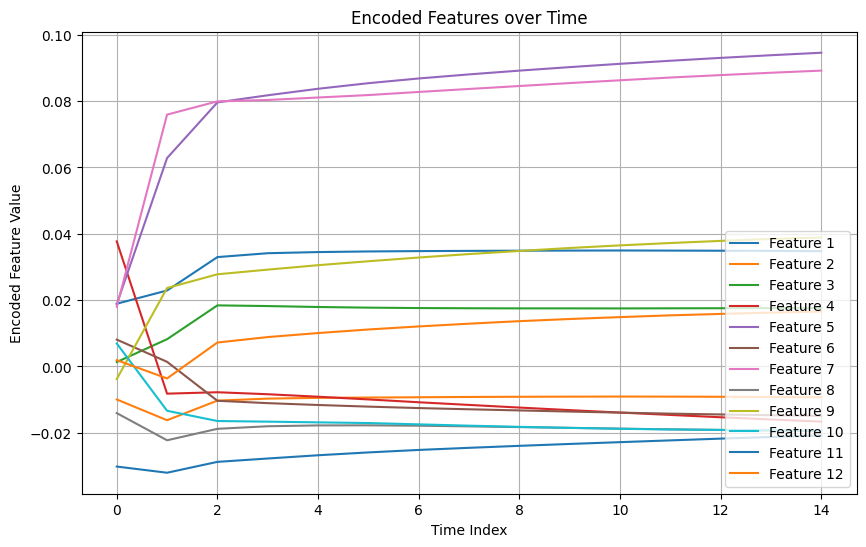

In [21]:
model_idx_num = 12700

model_idx = np.unique(validation_np[:, 1])[model_idx_num]

model_np = validation_np[validation_np[:, 1] == model_idx]

abundances = model_np[:, 3+DatasetConfig.num_physical_parameters:]

abundances_t = torch.from_numpy(abundances)

with torch.no_grad():
    encoded_features = dp.encoder_inferencing(autoencoder, abundances_t)

print(encoded_features)

time_indices = (model_np[:, 2] / 1000)[:15]
encoded_features_np = encoded_features.cpu().numpy()[:15]

plt.figure(figsize=(10, 6))
for i in range(encoded_features_np.shape[1]):  # Loop through encoded feature dimensions
    plt.plot(time_indices, encoded_features_np[:, i], label=f'Feature {i+1}')

plt.xlabel("Time Index")
plt.ylabel("Encoded Feature Value")
plt.title("Encoded Features over Time")
plt.legend(loc="lower right")
plt.grid(True)
plt.show()